In [1]:
import os
import pandas as pd
import matplotlib as mpl
from matplotlib import pyplot as plt
import numpy as np
from scipy.sparse import csr_matrix
from scipy import stats
import umap

import anndata as ad
import scanpy as sc
import squidpy as sq
import seaborn as sns
import h5py
from matplotlib_scalebar.scalebar import ScaleBar
from tqdm import tqdm

# mpl.rcParams.update(mpl.rcParamsDefault) #Reset rcParams to default
# colors = plt.rcParams['axes.prop_cycle'].by_key()['color']  # Colors in this style

# # Plotting style function (run this before plotting the final figure)
def set_plotting_style():
    plt.style.use('seaborn-paper')
    plt.rc('axes', labelsize=12)
    plt.rc('axes', titlesize=12)
    plt.rc('xtick', labelsize=10)
    plt.rc('ytick', labelsize=10)
    plt.rc('legend', fontsize=10)
    plt.rc('text.latex', preamble=r'\usepackage{sfmath}')
    plt.rc('xtick.major', pad=2)
    plt.rc('ytick.major', pad=2)
    plt.rc('mathtext', fontset='stixsans', sf='sansserif')
    plt.rc('figure', figsize=[10,9])
    plt.rc('svg', fonttype='none')

2022-12-21 21:20:24.015520: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
#Define the path where the files are located
DATA_PATH=('/mnt/ibm_lg/leah.dorman/Nanostring/Data/IBD_Michael_Kattah/')
data_files = os.listdir(os.path.join(DATA_PATH,'annotated_data'))
print(data_files)
filename = data_files[2]
print(filename)
#pick '22_10_4_CosMx_umap_V5.h5ad'

['.ipynb_checkpoints', 'KNFC5VYF', '22_10_4_CosMx_umap_V5.h5ad', 'finalized_ndata_obj_12_13_2022.h5ad']
22_10_4_CosMx_umap_V5.h5ad


In [3]:
ndata = sc.read_h5ad(os.path.join(DATA_PATH,'annotated_data',filename))
print(ndata)
metadata = ndata.obs

AnnData object with n_obs × n_vars = 64699 × 979
    obs: 'Height', 'total_counts_mt', 'Endoscopic_severity', 'R_vs_L', 'leiden_v10_r1.6', 'Patient_samples', 'AspectRatio', 'Mean.CD3', 'pct_counts_mt', 'leiden_v8_r1.6', 'Width', 'fine_annotation', 'Coarse_annotation', 'leiden_v9_r0.4', 'Mean.CD45', 'n_genes_by_counts', 'fov', 'Condition', 'n_genes', 'total_counts'
    var: 'mean', 'n_cells', 'n_cells_by_counts', 'mt', 'std', 'mean_counts', 'variance', 'total_counts', 'pct_dropout_by_counts'
    obsm: 'X_latent_latent_latent_latent_pca', 'X_latent_latent_latent_pca', 'X_latent_latent_pca', 'X_latent_pca', 'X_pca', 'X_spatial', 'X_spatial_fov', 'X_spatial_global', 'X_umap'
    layers: 'log_normalized_counts', 'raw_counts'
    obsp: 'N_latent_latent_latent_pca', 'N_latent_latent_pca', 'N_latent_pca', 'N_pca', 'N_spatial', 'N_spatial_fov', 'N_spatial_global', 'N_umap'


In [4]:
metadata.Condition.value_counts()

HC     24660
VDZ    22583
UC     17456
Name: Condition, dtype: int64

In [5]:
#Define the path where the files are located
DATA_PATH=('/mnt/ibm_lg/leah.dorman/Nanostring/Data/IBD_Michael_Kattah/')
data_files = os.listdir(os.path.join(DATA_PATH,'processed_data'))
filename = data_files[2]
print(filename) #nanostring_IBD_normalized_umap_12_13_22.h5ad

nanostring_IBD_normalized_umap_12_13_22.h5ad


In [6]:
ndata = sc.read_h5ad(os.path.join(DATA_PATH,'processed_data',filename))
ndata.obs.columns

Index(['fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px',
       'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain',
       'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.CD3',
       'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'n_genes_by_counts',
       'total_counts', 'total_counts_ercc', 'pct_counts_ercc', 'n_genes',
       'n_counts'],
      dtype='object')

/tmp/ipykernel_4157347/3296651453.py:6: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  ndata.obs.loc[metadata.index,column]=metadata[column]
/tmp/ipykernel_4157347/3296651453.py:6: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  ndata.obs.loc[metadata.index,column]=metadata[column]
/tmp/ipykernel_4157347/3296651453.py:6: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-uniq

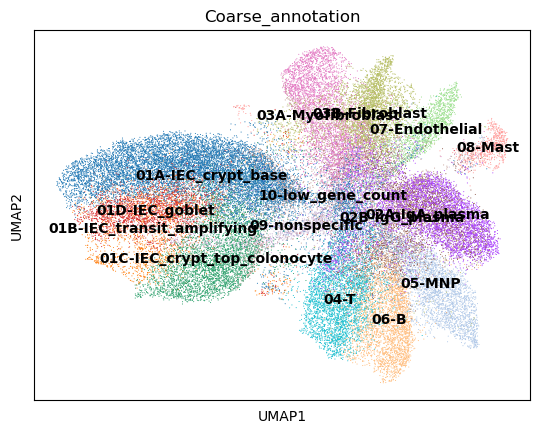

/home/leah.dorman/anaconda3/envs/anno/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


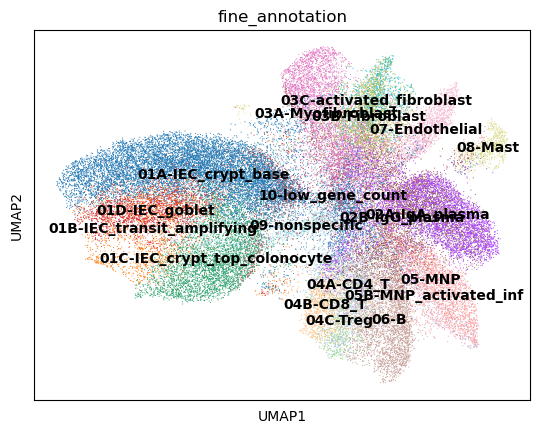

In [7]:
metadata = metadata[metadata.index.isin(ndata.obs.index)]
for column in list(metadata.columns):
    if column in list(ndata.obs.columns):
        continue
    else:
        ndata.obs.loc[metadata.index,column]=metadata[column]

        
sc.pl.umap(ndata,color='Coarse_annotation',legend_loc='on data',save = 'coarse_annotated_pre.pdf')
sc.pl.umap(ndata,color='fine_annotation',legend_loc = 'on data',save = 'fine_annotated_pre.pdf')

In [8]:
#edit the annotations as Michael requested
ndata.obs.Coarse_annotation=ndata.obs.Coarse_annotation.astype('str')
ndata.obs.fine_annotation=ndata.obs.fine_annotation.astype('str')
ndata.obs.loc[ndata.obs.Coarse_annotation=='01D-IEC_goblet','Coarse_annotation']='01D-IEC_base_2'
ndata.obs.loc[ndata.obs.fine_annotation=='01D-IEC_goblet','fine_annotation']='01D-IEC_base_2'

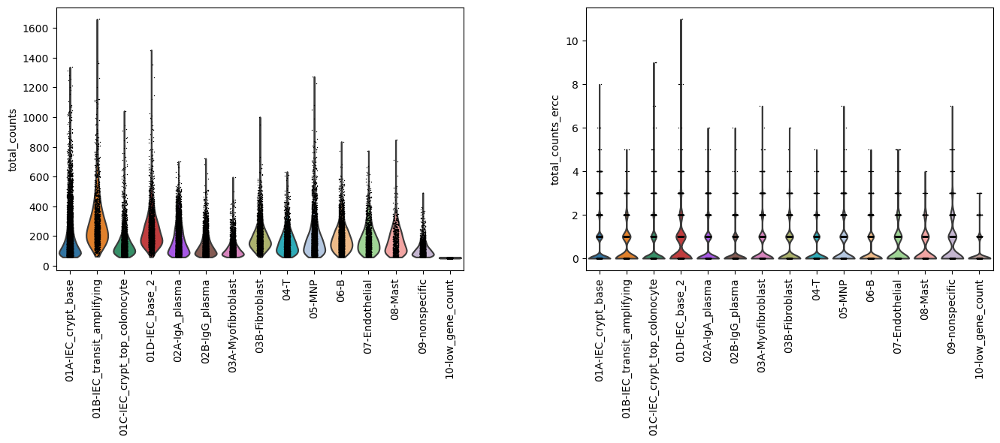

In [9]:
sc.pl.violin(ndata,['total_counts','total_counts_ercc'],groupby='Coarse_annotation',rotation=90,save = 'qc_annotated_vln.pdf')

In [10]:
#remove the two un-annotated groups
ndata = ndata[~ndata.obs.Coarse_annotation.isin(['09-nonspecific','10-low_gene_count'])].copy()

/home/leah.dorman/anaconda3/envs/anno/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


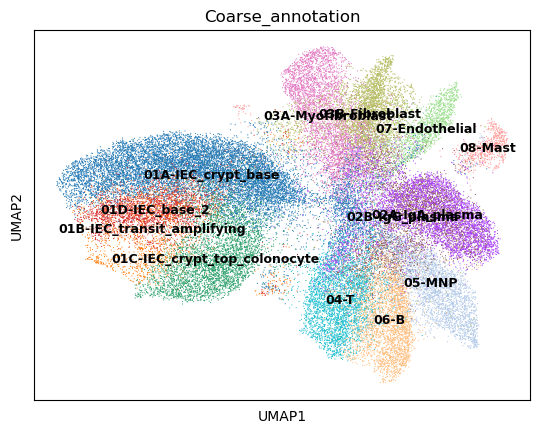

/home/leah.dorman/anaconda3/envs/anno/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


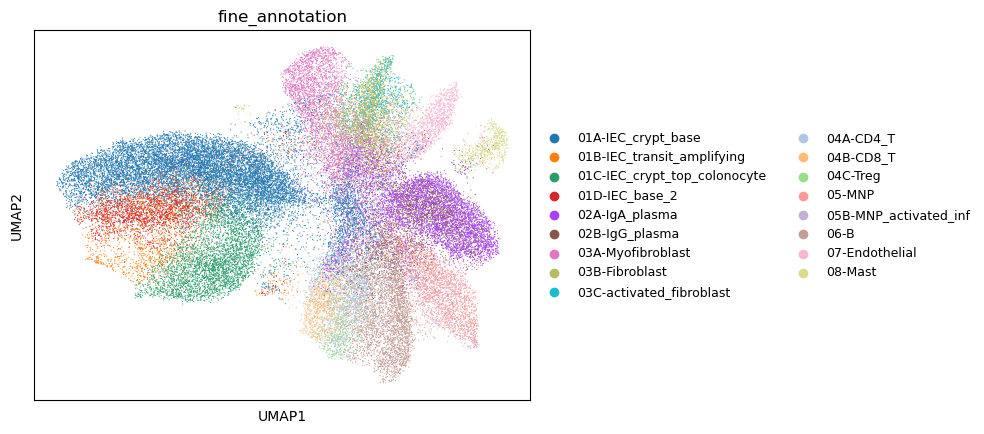

In [12]:
sc.pl.umap(ndata,color='Coarse_annotation',legend_loc='on data',legend_fontsize=9,save = 'coarse_annotated_post.pdf')

sc.pl.umap(ndata,color='fine_annotation',legend_loc='right margin',legend_fontsize=9,save = 'fine_annotated_post.pdf')


In [ ]:
#replace ndata.X so that the file is more readable in excellxgene
ndata.X=ndata.layers['log_normalized_counts']

VDZ    18903
HC     16767
UC     13113
Name: Condition, dtype: int64


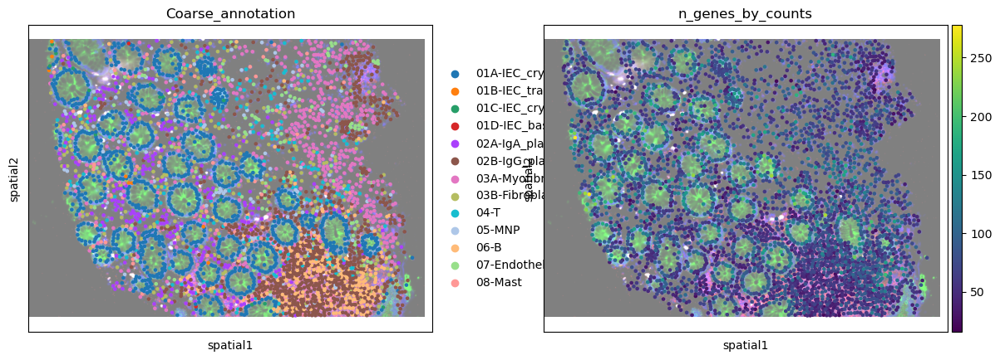

In [51]:
print(ndata.obs.Condition.value_counts())
sc.pl.spatial(ndata[ndata.obs.fov=='1'], color=["Coarse_annotation","n_genes_by_counts"], 
              library_id="1",alpha_img=0.5,spot_size=50,save = 'fov_1_annotation_superimposed.pdf')

# 1st field of view

In [52]:
ndata.write_h5ad(os.path.join(DATA_PATH,'annotated_data','finalized_ndata_obj_12_13_2022.h5ad'))

Check marker gene expression

In [53]:
marker_genes = {
    'CD4_T_Cell':['CD3D', 'CD40LG', 'IL7R'],
    'B_Cell':['CD52','CD37','MS4A1'],
    'mDendritic_Cell':['CLEC7A','CLEC10A'],
    'Endothelial':['KDR','RAMP3','VWF','PECAM1'],
    'Fibroblast':['MYH11','ACTA2','ACTG2'],
    'CD8_T_Cell':['KLRK1','CCL5'],
    'Crypt_TA_Cell':['SPINK1','AGR2','OLFM4'],
    'Macrophage':['C1QC','GPNMB','C1QB'],
    'Monocyte':['ITGAX','FGR','S100A8'],
    'Epithelial':['CEACAM6','KRT19','KRT20','CEACAM1','EPCAM','PIGR','KRT8'],
    'Treg':['CTLA4','FOXP3'],
    'NK_CD8_Cell':['GZMA','ITGAE','GZMH'],
    'Inflammatory_Macrophage':['MMP9','PTGDS','CCL18'],
    'Plasma_Cell':['IRF4','JCHAIN','MZB1'],
    'Mast_Cell':['TPSB2','TPSAB1','CPA3'],
    'ILC3':['KIT'], #,'RORC'
    'Enteric_Neurons':['CRYAB','S100B','NRXN1'], #'PLP1'
}


CD4_T_Cell


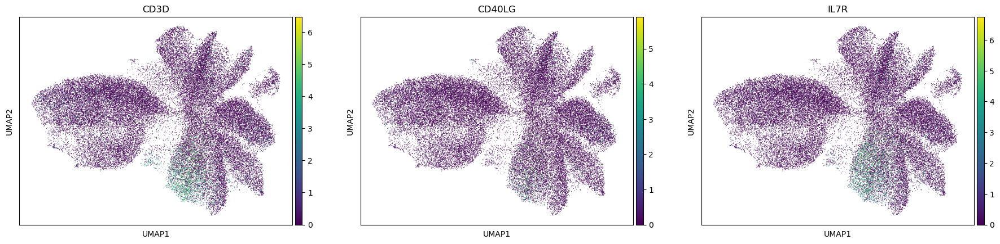

B_Cell


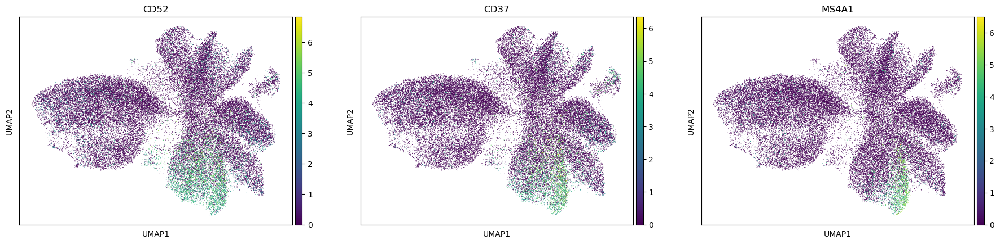

mDendritic_Cell


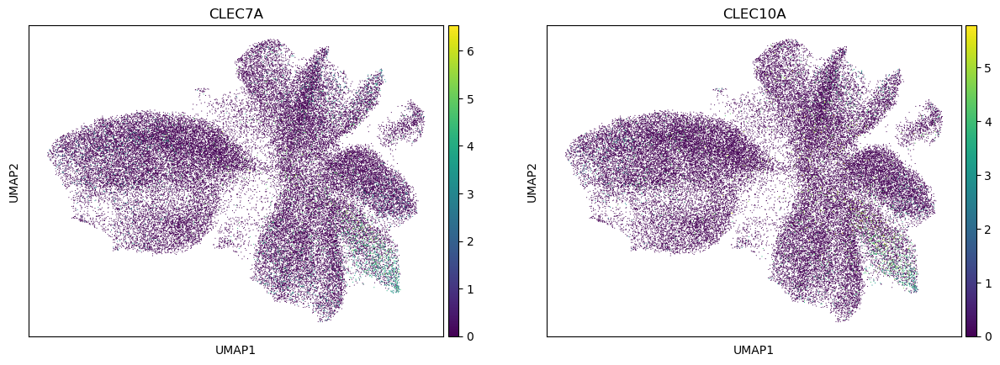

Endothelial


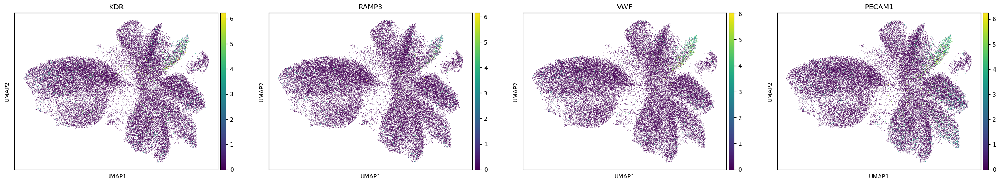

Fibroblast


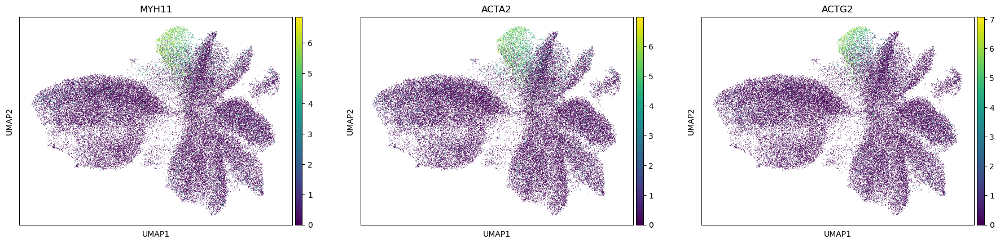

CD8_T_Cell


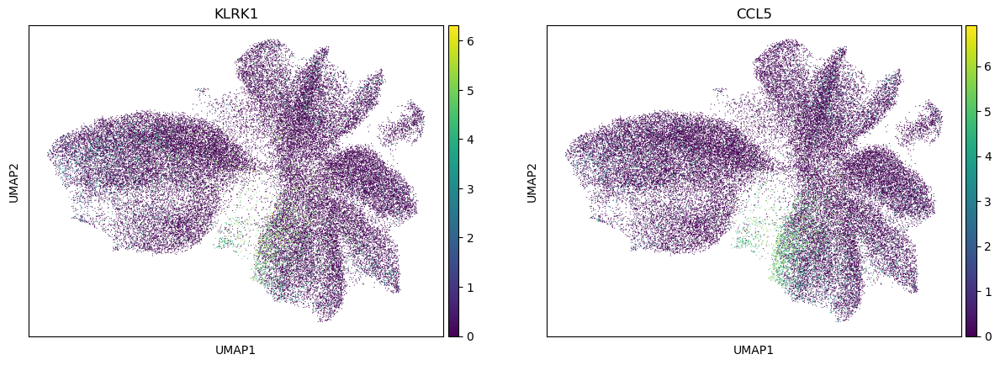

Crypt_TA_Cell


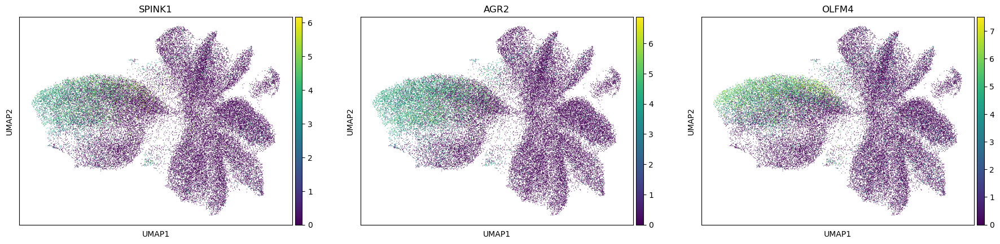

Macrophage


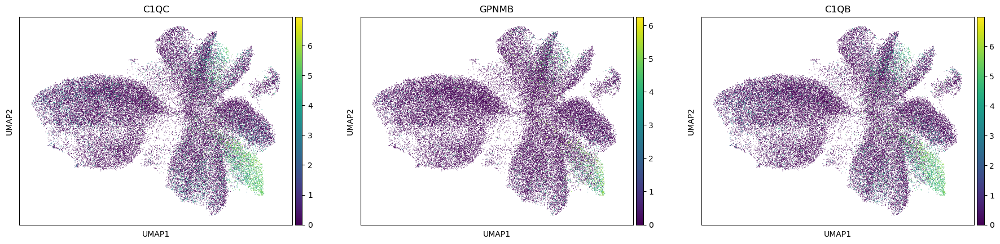

Monocyte


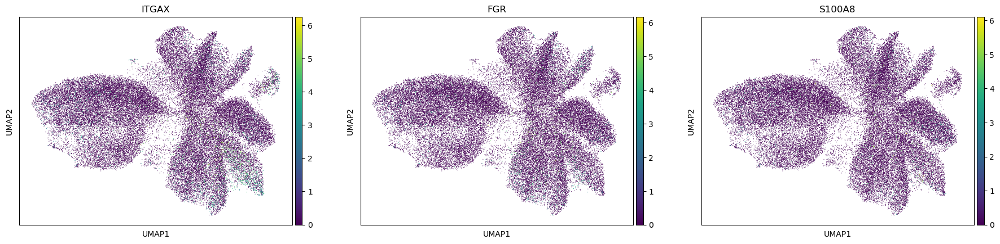

Epithelial


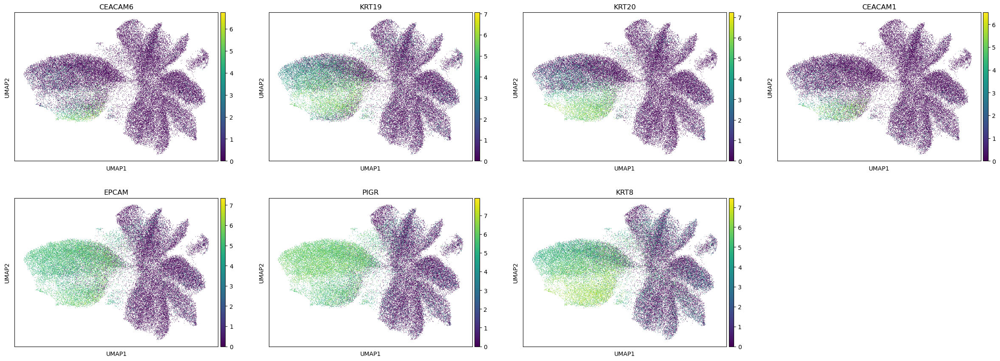

Treg


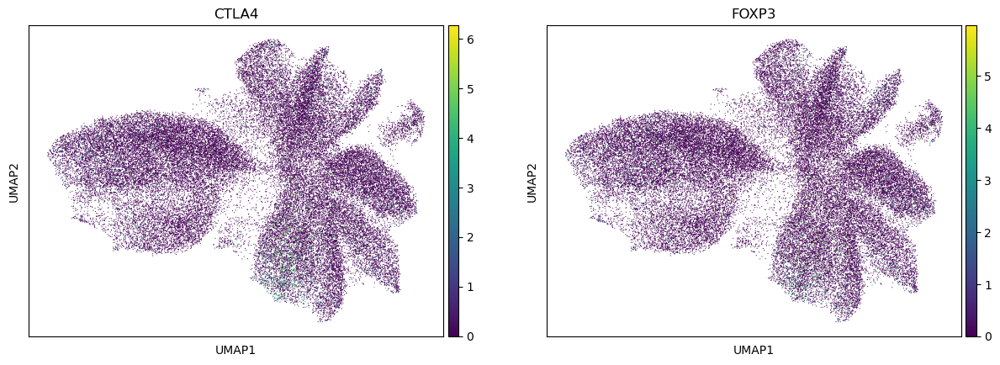

NK_CD8_Cell


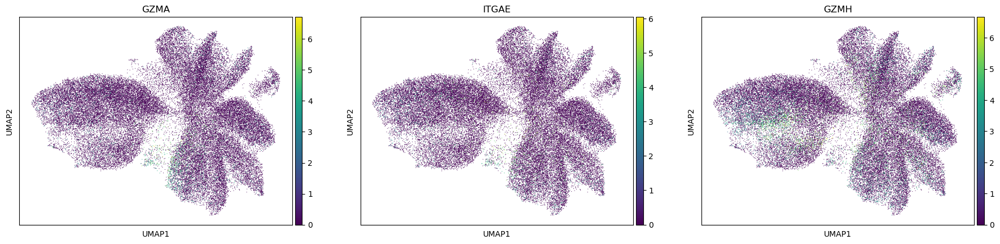

Inflammatory_Macrophage


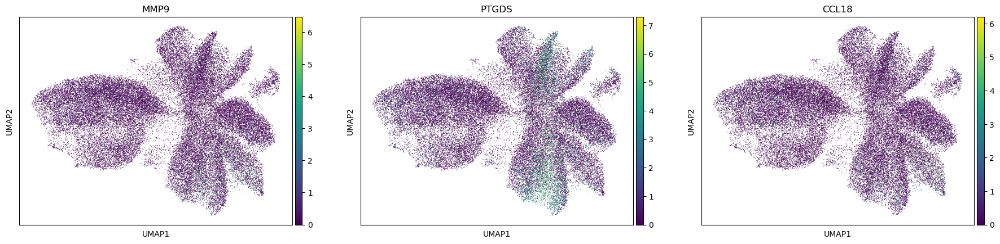

Plasma_Cell


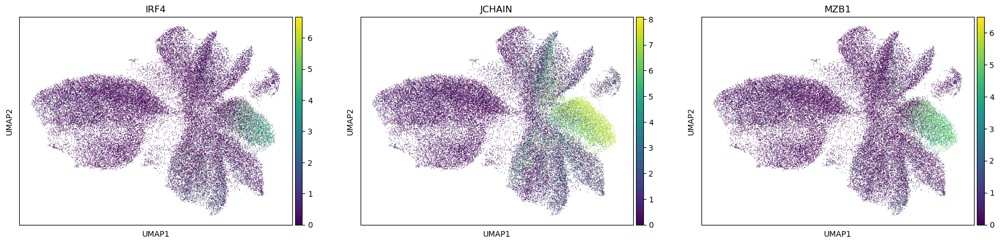

Mast_Cell


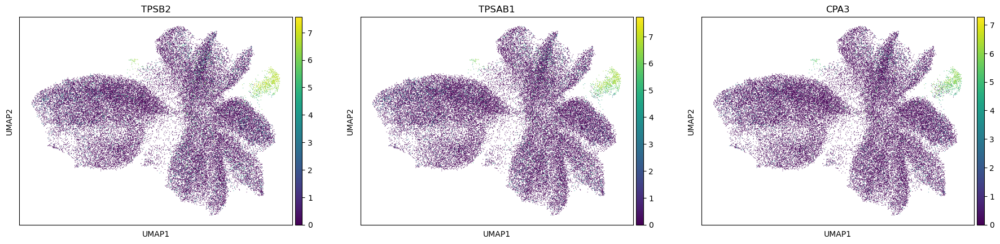

ILC3


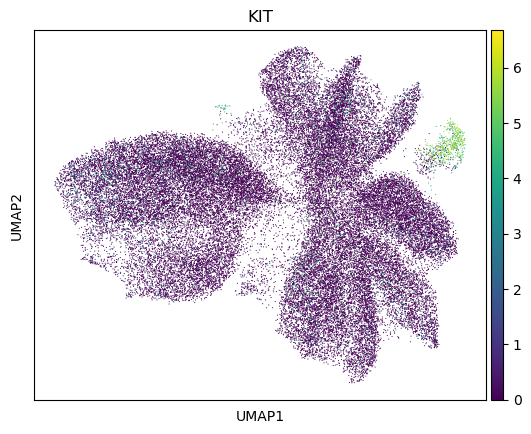

Enteric_Neurons


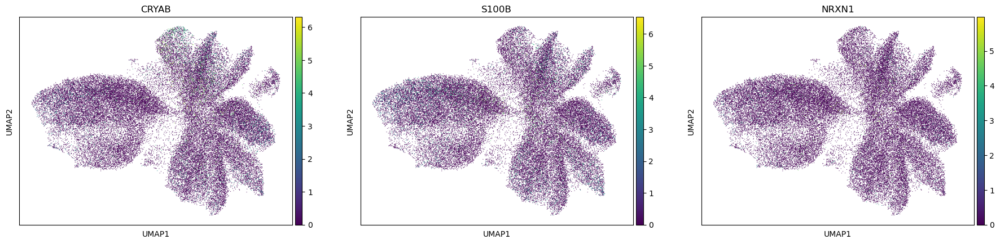

In [54]:
for celltype in marker_genes.keys():
    print(celltype)
    sc.pl.umap(ndata,color=marker_genes[celltype])

/home/leah.dorman/anaconda3/envs/anno/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


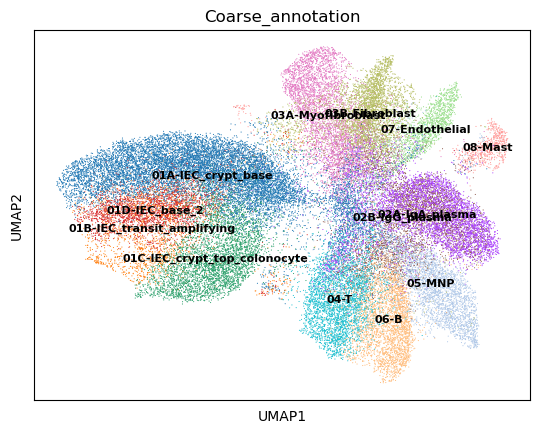

/home/leah.dorman/anaconda3/envs/anno/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


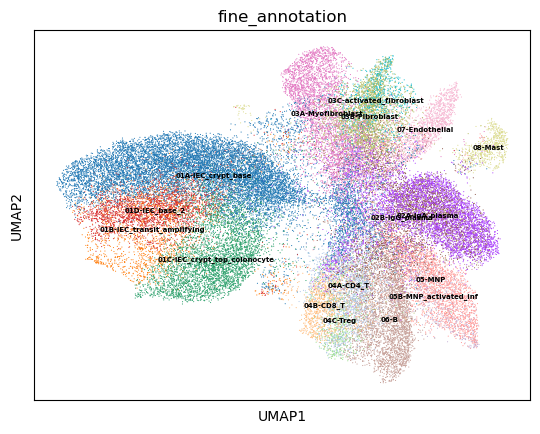

In [55]:
sc.pl.umap(ndata,color='Coarse_annotation',legend_loc='on data',legend_fontsize=8)
sc.pl.umap(ndata,color='fine_annotation',legend_loc='on data',legend_fontsize=5)

In [56]:
ndata.obs.fine_annotation.value_counts()

01A-IEC_crypt_base              12231
02A-IgA_plasma                   4923
01C-IEC_crypt_top_colonocyte     4206
02B-IgG_plasma                   4067
03A-Myofibroblast                3671
06-B                             3150
05-MNP                           2594
03B-Fibroblast                   2444
01D-IEC_base_2                   2350
04A-CD4_T                        1875
01B-IEC_transit_amplifying       1814
07-Endothelial                   1515
04B-CD8_T                        1053
03C-activated_fibroblast          910
08-Mast                           701
05B-MNP_activated_inf             684
04C-Treg                          595
Name: fine_annotation, dtype: int64

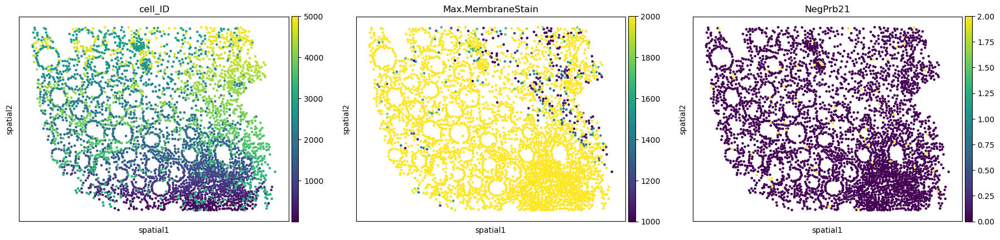

/home/leah.dorman/anaconda3/envs/anno/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/leah.dorman/anaconda3/envs/anno/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


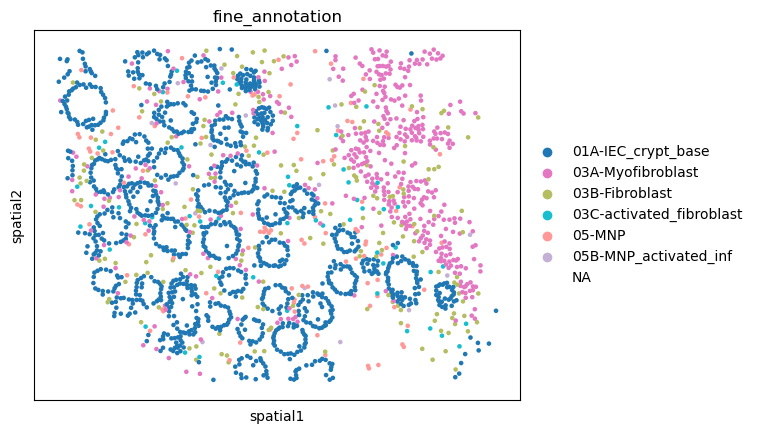

/home/leah.dorman/anaconda3/envs/anno/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/leah.dorman/anaconda3/envs/anno/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


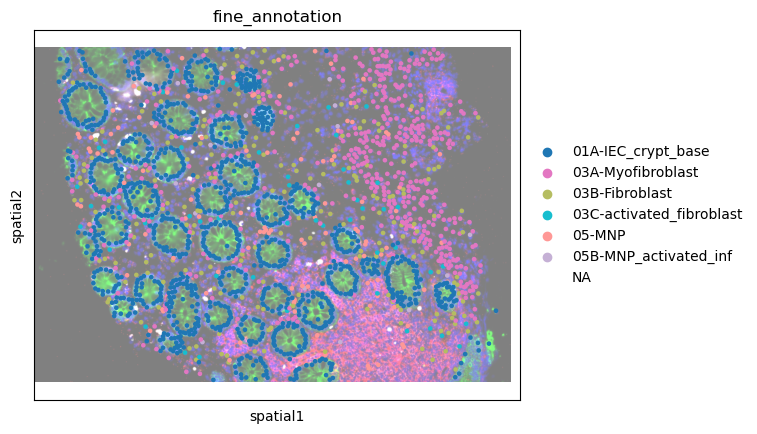

In [58]:
# Check if the raw staining images are also loaded - This needs to be explored further to see what we'd like to visualize)
sc.pl.spatial(ndata[ndata.obs.fov=='1'], color=["cell_ID","Max.MembraneStain","NegPrb21"],
              vmax=[5000,2000,2], vmin=[1, 1000, 0],
              alpha_img=0, library_id='1',spot_size=50) # 1st field of view

sc.pl.spatial(ndata[ndata.obs.fov=='1'], color=['fine_annotation'],groups = ['03A-Myofibroblast','03B-Fibroblast','01A-IEC_crypt_base','05-MNP','03C-activated_fibroblast','05B-MNP_activated_inf'],
              alpha_img=0, library_id="1", spot_size=50) # 1st field of view

sc.pl.spatial(ndata[ndata.obs.fov=='1'], color=['fine_annotation'],groups = ['03A-Myofibroblast','03B-Fibroblast','01A-IEC_crypt_base','05-MNP','03C-activated_fibroblast','05B-MNP_activated_inf'],
              alpha_img=0.5, library_id="1", spot_size=50,save = 'subset_superimposed_fov1.pdf') # 1st field of view

In [65]:
#make a table comparing condition and celltype
tab = ndata.obs.groupby(['Condition', 'fine_annotation']).size()
x = tab.unstack().transpose()
fibro=x.loc[['03B-Fibroblast','03C-activated_fibroblast','03A-Myofibroblast']]
macro=x.loc[['05-MNP','05B-MNP_activated_inf']]


#calculate totals per condition and per celltype
total_per_condition = fibro.sum(axis=0)
fibro = pd.concat([fibro, total_per_condition.to_frame().T], ignore_index=False)

total_per_celltype = fibro.sum(axis=1)
fibro['total_per_celltype']=total_per_celltype

#calculate totals per condition and per celltype
total_per_condition = macro.sum(axis=0)
macro = pd.concat([macro, total_per_condition.to_frame().T], ignore_index=False)

total_per_celltype = macro.sum(axis=1)
macro['total_per_celltype']=total_per_celltype

print("fibroblasts",'\n',fibro)
print("macrophages",'\n',macro)

fibroblasts 
 Condition                   HC    UC   VDZ  total_per_celltype
03B-Fibroblast             552   685  1207                2444
03C-activated_fibroblast   186   265   459                 910
03A-Myofibroblast         1084  1244  1343                3671
0                         1822  2194  3009                7025
macrophages 
 Condition                HC   UC   VDZ  total_per_celltype
05-MNP                  948  711   935                2594
05B-MNP_activated_inf   217  240   227                 684
0                      1165  951  1162                3278


In [ ]:
print("macrophages",'\n',macro/macro.loc[0]*100)
print("fibroblasts",'\n',fibro/fibro.loc[0]*100)

In [ ]:
#show distribution of genes detected by field of view
sc.pl.violin(ndata, ['n_genes_by_counts', 'total_counts','total_counts_ercc'], groupby='fov',
             jitter=0.2, multi_panel=True)

sc.pl.violin(ndata, ['n_genes_by_counts', 'total_counts','total_counts_ercc'], groupby='Coarse_annotation',
             jitter=0.2, multi_panel=True,rotation=90)

In [ ]:
# check the distribution of the cell area
plt.hist(ndata.obs['Area'], bins=50)

In [ ]:
#show correlation between cell size and number of genes detected
sc.pl.scatter(ndata, x='Area', y='n_genes_by_counts',color='fov')
sc.pl.scatter(ndata, x='Area', y='total_counts_ercc',color='fov')

In [ ]:
#highest expressed genes
sc.pl.highest_expr_genes(ndata, n_top=20)


#add umap, then save normalized (not scaled) 

#add log normalized counts to adata.raw
#adata.raw = adata (after normalization) because sc defaults to use .raw for DE

#look at how noisy marker gene expression is

#save fov images + h5ad 

In [ ]:
sc.pp.calculate_qc_metrics(ndata, qc_vars=['ercc'], percent_top=None, log1p=False, inplace=True)
sc.pl.violin(ndata, ['n_genes_by_counts', 'total_counts', 'pct_counts_ercc'],
             jitter=0.4, stripplot=False, multi_panel=True)

In [ ]:
ndata.X = ndata.layers['raw_counts']
sc.pl.scatter(ndata, x='total_counts', y='n_genes_by_counts',color='fov')

Show expression of cell type specific marker genes within the UMAP plot for all fields of view

In [63]:
ndata.obs.Patient_samples.value_counts()

06-HS8_UC_L_1      4888
04-HS12_VDZ_L_1    4319
09-HS10_VDZ_L_1    3939
01-HS10_VDZ_R_0    3826
21-HS2_HC_L_0      3792
11-HS5_UC_R_0      3774
02-HS11_VDZ_L_3    3750
03-HS11_VDZ_R_0    3069
13-HS7_UC_L_0      2395
14-HS2_HC_R_0      2229
16-HS4_HC_L_0      2199
17-HS4_HC_R_0      2063
05-HS7_UC_R_1      2056
20-HS1_HC_R_0      1832
19-HS1_HC_L_0      1721
18-HS1_HC_L_0      1578
15-HS3_HC_R_0      1353
Name: Patient_samples, dtype: int64

In [64]:
ndata.obs.fov.value_counts()

6     4888
4     4319
9     3939
1     3826
21    3792
11    3774
2     3750
3     3069
13    2395
14    2229
16    2199
17    2063
5     2056
20    1832
19    1721
18    1578
15    1353
Name: fov, dtype: int64